## Imports


In [1]:
import argparse
import math
import random
import os
import time
from dataclasses import dataclass
from typing import List, Tuple

import numpy as np
import pybullet as p
import pybullet_data
from env import DiffBotEnv, RobotParams


pybullet build time: Nov  2 2025 19:45:45


## Test render env

In [4]:
p.disconnect()

numActiveThreads = 0
stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed


In [2]:
robot_params = RobotParams()

env = DiffBotEnv(gui=True, n_objects=10, seed=None, robot_params=robot_params)


Version = 4.1 Metal - 90.5
Vendor = Apple
Renderer = Apple M1
b3Printf: Selected demo: Physics Server
startThreads creating 1 threads.
starting thread 0
started thread 0 
MotionThreadFunc thread started
YCB URDFS: ['urdfs/ycb/ycb_assets/015_peach.urdf', 'urdfs/ycb/ycb_assets/071_nine_hole_peg_test.urdf', 'urdfs/ycb/ycb_assets/037_scissors.urdf', 'urdfs/ycb/ycb_assets/032_knife.urdf', 'urdfs/ycb/ycb_assets/058_golf_ball.urdf', 'urdfs/ycb/ycb_assets/029_plate.urdf', 'urdfs/ycb/ycb_assets/021_bleach_cleanser.urdf', 'urdfs/ycb/ycb_assets/010_potted_meat_can.urdf', 'urdfs/ycb/ycb_assets/072-a_toy_airplane.urdf', 'urdfs/ycb/ycb_assets/063-a_marbles.urdf', 'urdfs/ycb/ycb_assets/073-e_lego_duplo.urdf', 'urdfs/ycb/ycb_assets/065-c_cups.urdf', 'urdfs/ycb/ycb_assets/019_pitcher_base.urdf', 'urdfs/ycb/ycb_assets/008_pudding_box.urdf', 'urdfs/ycb/ycb_assets/072-d_toy_airplane.urdf', 'urdfs/ycb/ycb_assets/065-h_cups.urdf', 'urdfs/ycb/ycb_assets/059_chain.urdf', 'urdfs/ycb/ycb_assets/073-b_lego_duplo

# Policy

In [3]:
import torch
from PIL import Image
import clip

# Load CLIP model
device = "mps" if torch.backends.mps.is_available() else ("cuda" if torch.cuda.is_available() else "cpu")
clip_model, clip_preprocess = clip.load("ViT-B/32", device=device)

In [4]:
def _to_pil(img_np):
    # img_np: HxWx3 uint8 from env.step(camera_feed=True) BVR
    # convert BGR to RGB
    img_np = img_np[:, :, ::-1]
    return Image.fromarray(img_np)

def _encode_text(prompt: str):
    with torch.no_grad():
        tokens = clip.tokenize([prompt]).to(device)
        txt = clip_model.encode_text(tokens)
        txt = txt / txt.norm(dim=-1, keepdim=True)
    return txt  # [1, d]

test_txt = _encode_text("a red ball")  # [1, d]
print(test_txt.shape) 

torch.Size([1, 512])


To choose the heading and speed we encode each sector of the image and take the one thats is the most similar to the text encoding

In [5]:
def _score_sectors(pil_img: Image.Image, text_emb: torch.Tensor, K=7):
    """
    Split the image into K vertical sectors, return CLIP cosine scores per sector.
    """
    W, H = pil_img.size
    w = W // K
    crops = []
    boxes = []
    for i in range(K):
        x0 = max(0, i*w - w//4)                 # small overlap
        x1 = min(W, x0 + w + w//2)
        crop = pil_img.crop((x0, 0, x1, H))
        crops.append(clip_preprocess(crop))
        boxes.append((x0, x1))
    imgs = torch.stack(crops).to(device)

    with torch.no_grad():
        img_feats = clip_model.encode_image(imgs)
        print(img_feats.shape)  #
        img_feats = img_feats / img_feats.norm(dim=-1, keepdim=True)  # [K, d]
        sims = (img_feats @ text_emb.T).squeeze(1)                    # [K]
    return sims, boxes

We then compute the angle needed to bring the most similar sector in the center of the image

In [6]:
def _sector_to_cmd(sims: torch.Tensor, K: int, fov_deg=120.0, v_max=10.00, w_gain=3.5, conf_th=0.12):
    """
    sims: [K] cosine scores. Pick argmax -> bearing in [-FOV/2, +FOV/2] (radians).
    Forward speed scales with confidence and reduces when turning sharply.
    """
    K = int(K)
    idx = int(torch.argmax(sims).item())
    fov = math.radians(fov_deg)
    # center angles for sectors
    bearings = np.linspace(-fov/2, fov/2, K)
    bearing = float(bearings[idx])
    conf = float(torch.softmax(sims, dim=0)[idx])
    # turn rate
    w = - w_gain * bearing

    # forward speed: zero if low confidence; otherwise slower when turning
    if conf < conf_th:
        v = 0.1
    else:
        v = v_max * conf * max(0.0, math.cos(bearing)) 
    return v, w, idx, conf

In [7]:
SMOOTH = 0.3
def compute_next_cmd(v, w, camera_feed, prompt):
    global text_emb, _prev_v, _prev_w
    if camera_feed is None:
        return 0.0, 0.0 # stop the robot if no camera feed

    text_emb = _encode_text(prompt)  # text is global for efficiency

    #converts the image and computes the sector scores
    pil = _to_pil(camera_feed)
    sims, _ = _score_sectors(pil, text_emb, K=7)
    print(sims)  #

    # Convert chosen sector to bearing & forward speed
    v_cmd, w_cmd, idx, conf = _sector_to_cmd(sims, K=7, fov_deg=90.0)

    # Smooth commands 
    v_sm = SMOOTH * _prev_v + (1.0 - SMOOTH) * v_cmd
    w_sm = SMOOTH * _prev_w + (1.0 - SMOOTH) * w_cmd
    _prev_v, _prev_w = v_sm, w_sm
    return float(v_sm), float(w_sm)

In [8]:
def plot_camera_feed(camera_feed):

    
    pil = _to_pil(camera_feed)
    # erase previous output
    display(pil)

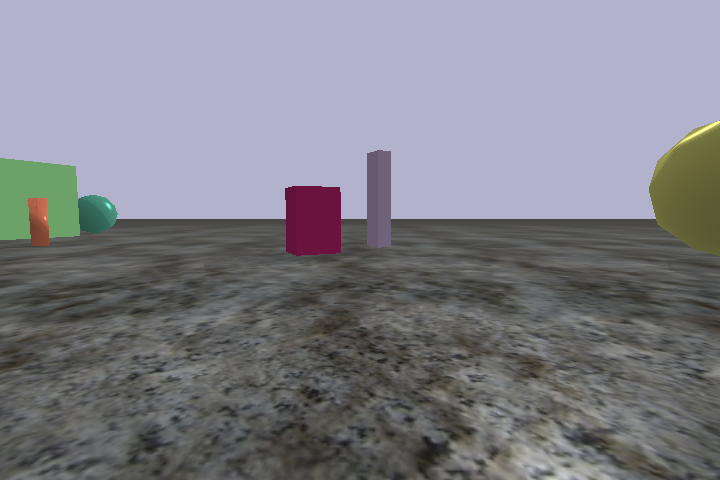

In [9]:
plot_camera_feed(env.step(steps=20, cmd=(0, 0), camera_feed=True))

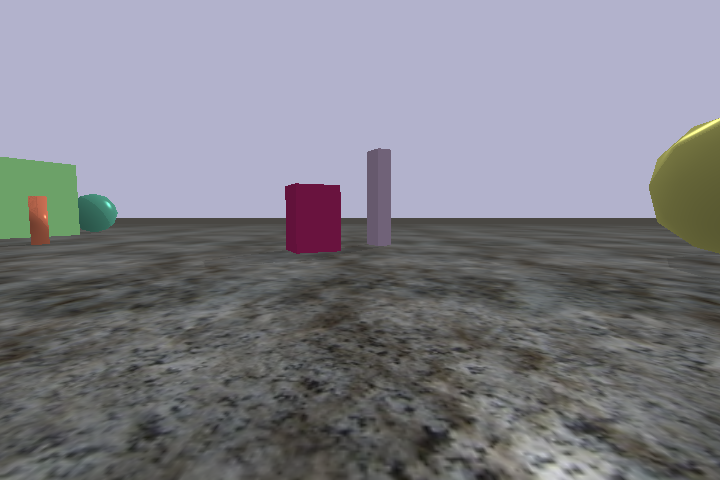

torch.Size([7, 512])
tensor([0.2964, 0.2625, 0.2600, 0.2603, 0.2507, 0.2378, 0.2544],
       device='mps:0', dtype=torch.float16)


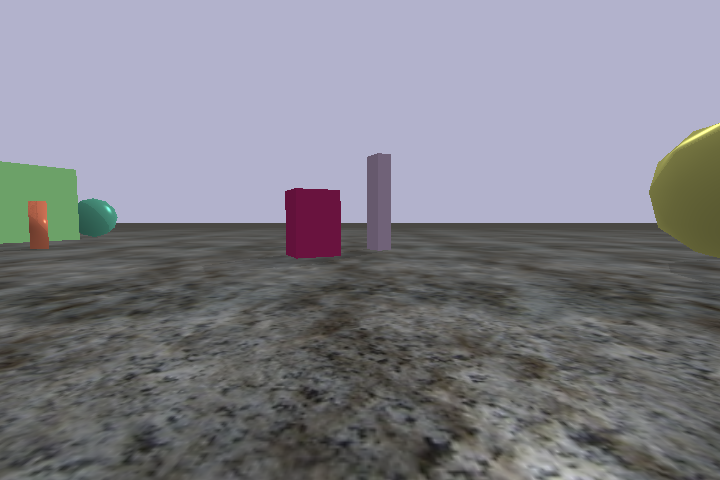

torch.Size([7, 512])
tensor([0.2981, 0.2520, 0.2607, 0.2605, 0.2485, 0.2378, 0.2517],
       device='mps:0', dtype=torch.float16)


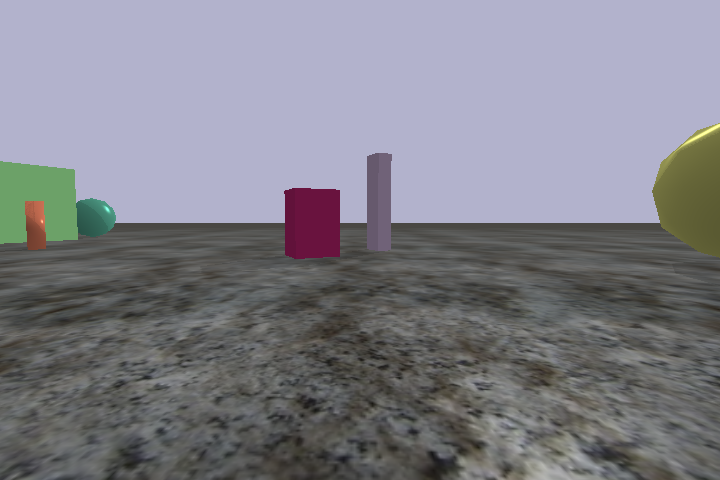

torch.Size([7, 512])
tensor([0.3018, 0.2585, 0.2603, 0.2515, 0.2467, 0.2374, 0.2556],
       device='mps:0', dtype=torch.float16)


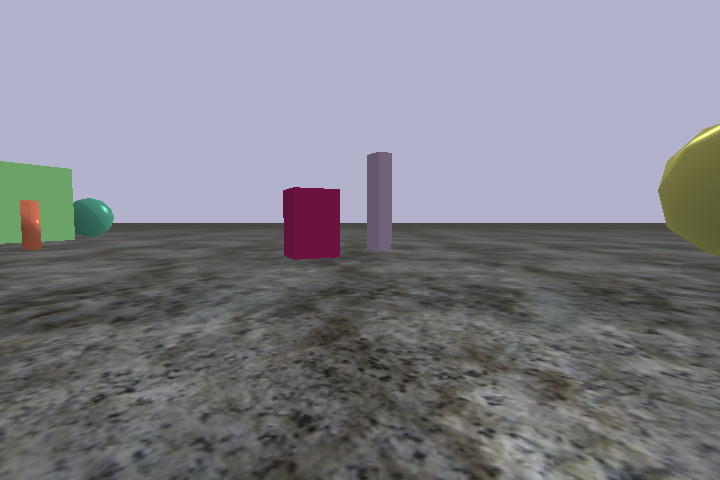

torch.Size([7, 512])
tensor([0.2974, 0.2627, 0.2629, 0.2559, 0.2468, 0.2380, 0.2603],
       device='mps:0', dtype=torch.float16)


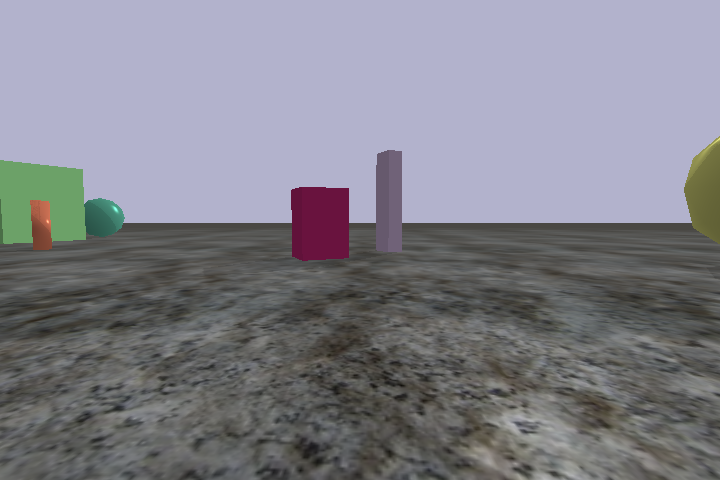

torch.Size([7, 512])
tensor([0.2964, 0.2673, 0.2612, 0.2661, 0.2505, 0.2415, 0.2546],
       device='mps:0', dtype=torch.float16)


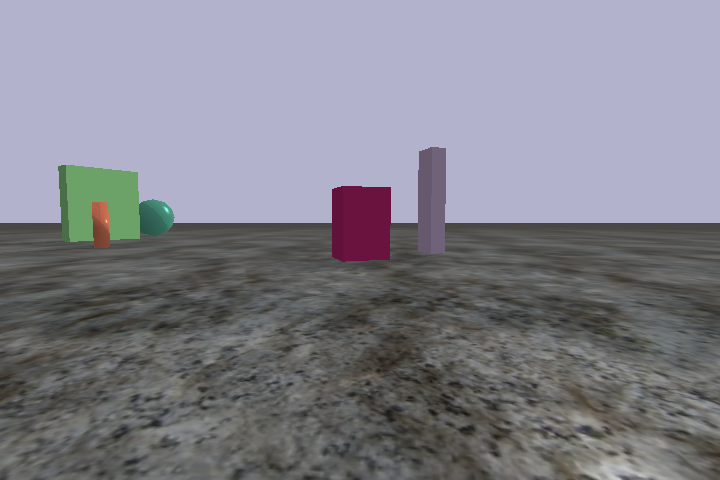

torch.Size([7, 512])
tensor([0.3101, 0.2937, 0.2456, 0.2668, 0.2476, 0.2412, 0.2361],
       device='mps:0', dtype=torch.float16)


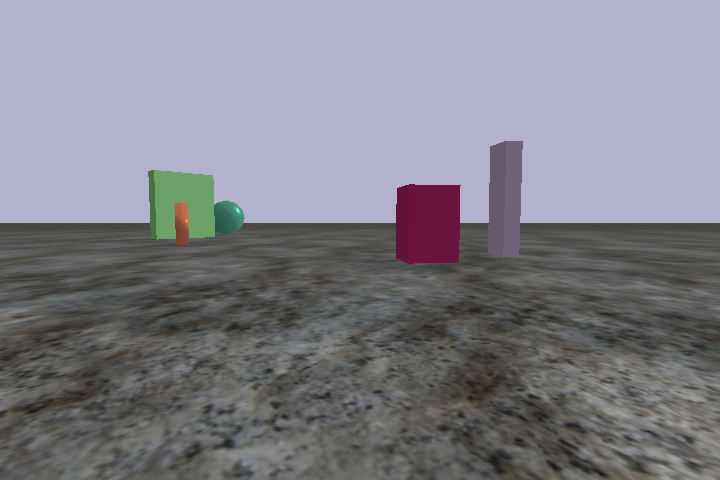

torch.Size([7, 512])
tensor([0.2622, 0.2998, 0.2866, 0.2637, 0.2515, 0.2507, 0.2385],
       device='mps:0', dtype=torch.float16)


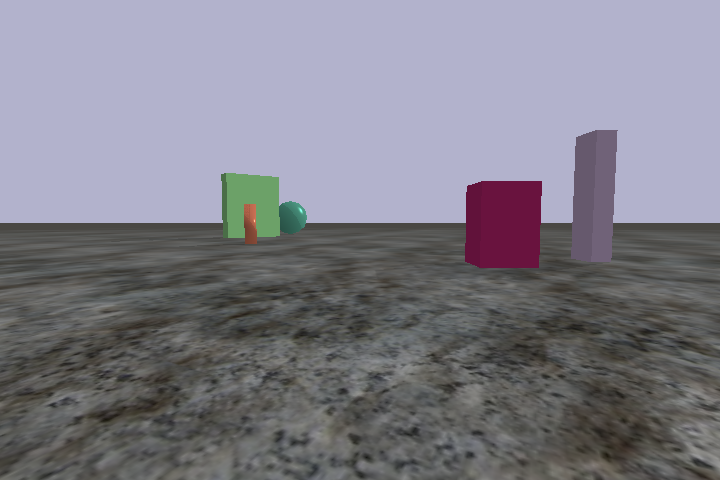

torch.Size([7, 512])
tensor([0.2347, 0.2734, 0.3020, 0.2581, 0.2693, 0.2563, 0.2520],
       device='mps:0', dtype=torch.float16)


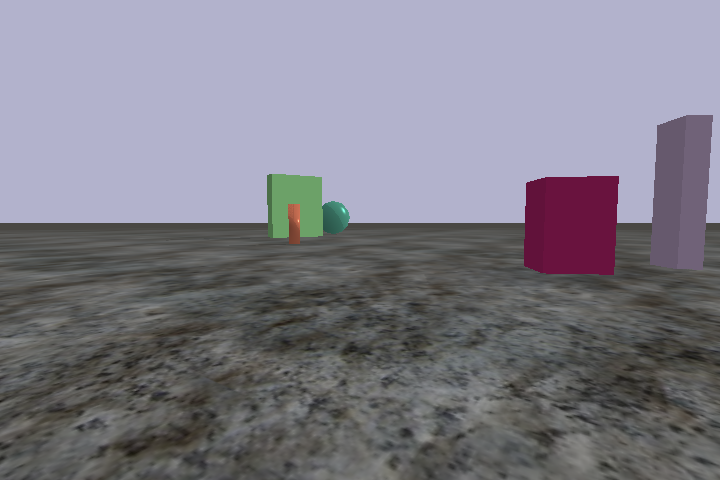

torch.Size([7, 512])
tensor([0.2384, 0.2388, 0.2927, 0.2979, 0.2333, 0.2727, 0.2378],
       device='mps:0', dtype=torch.float16)


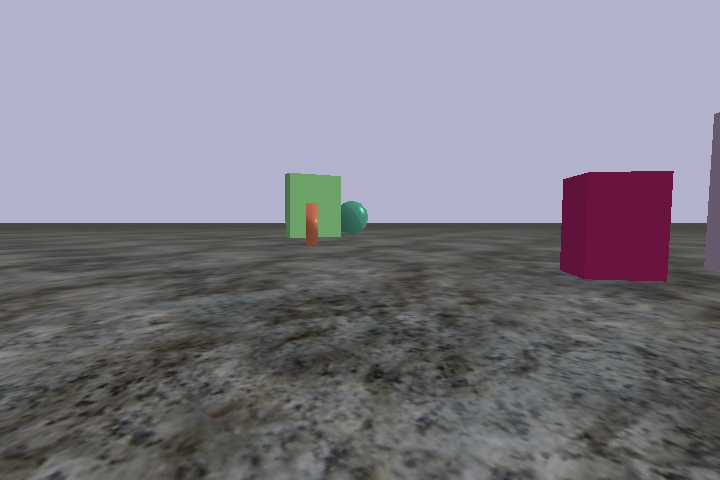

torch.Size([7, 512])
tensor([0.2322, 0.2427, 0.2983, 0.3059, 0.2417, 0.2571, 0.2346],
       device='mps:0', dtype=torch.float16)


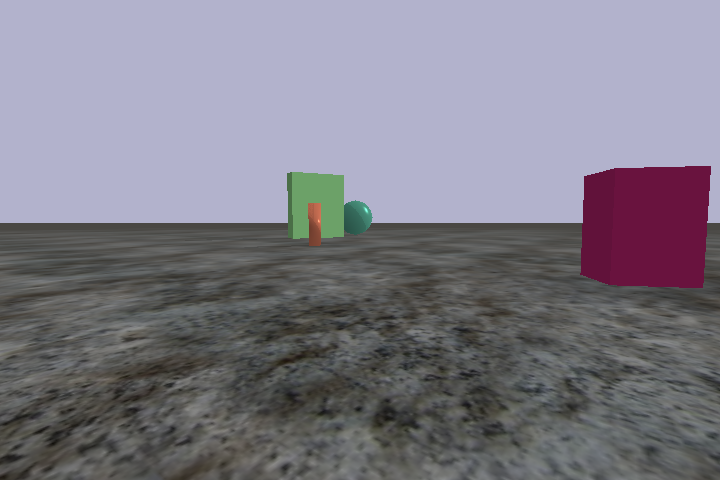

torch.Size([7, 512])
tensor([0.2382, 0.2406, 0.2991, 0.3081, 0.2399, 0.2593, 0.2493],
       device='mps:0', dtype=torch.float16)


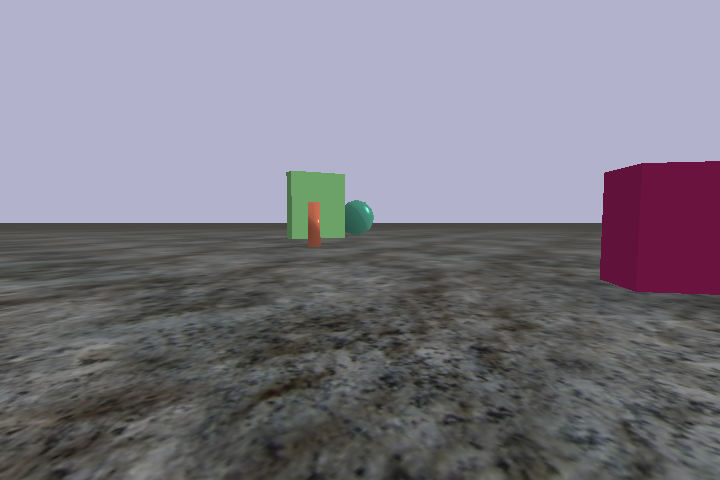

torch.Size([7, 512])
tensor([0.2378, 0.2371, 0.2976, 0.3127, 0.2360, 0.2615, 0.2449],
       device='mps:0', dtype=torch.float16)


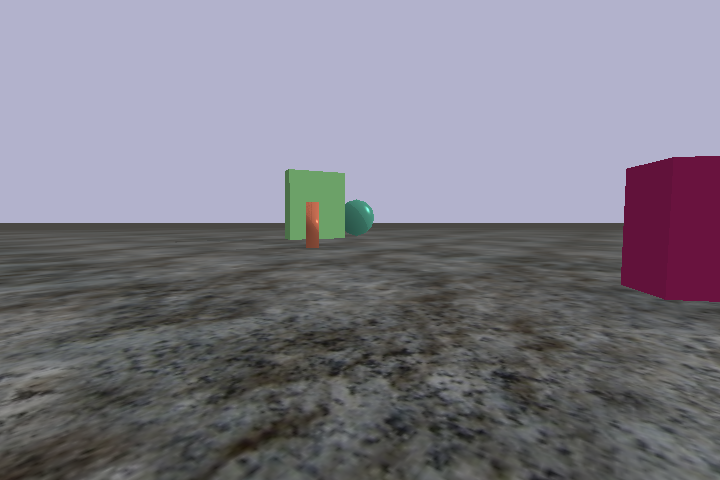

torch.Size([7, 512])
tensor([0.2327, 0.2345, 0.3049, 0.3088, 0.2377, 0.2405, 0.2391],
       device='mps:0', dtype=torch.float16)


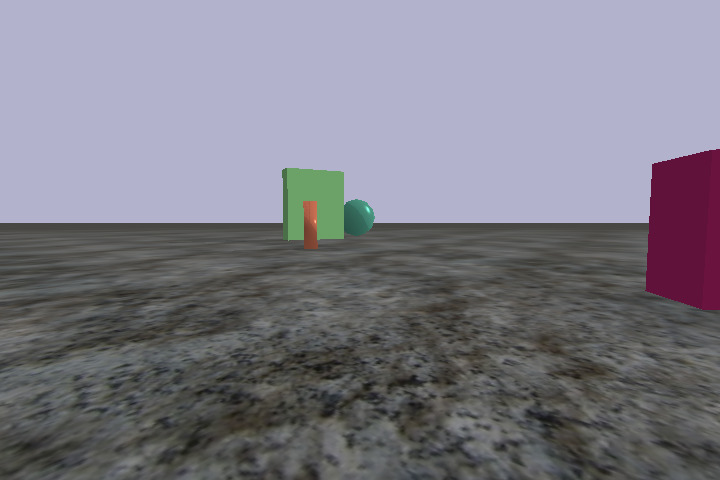

torch.Size([7, 512])
tensor([0.2377, 0.2408, 0.3025, 0.3018, 0.2338, 0.2377, 0.2383],
       device='mps:0', dtype=torch.float16)


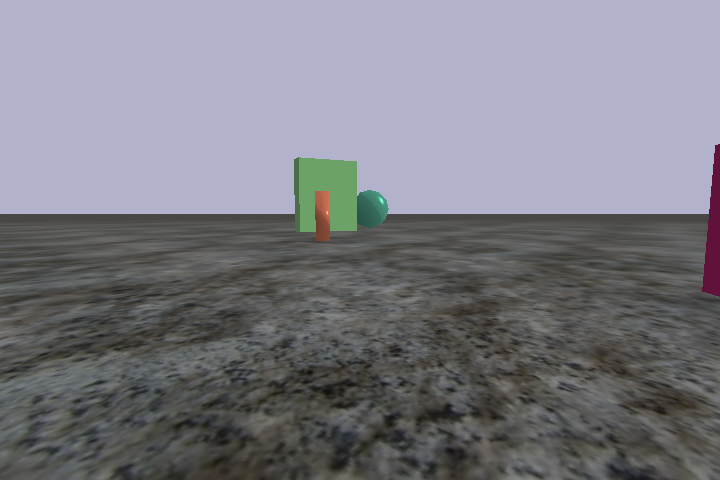

torch.Size([7, 512])
tensor([0.2295, 0.2368, 0.2861, 0.3040, 0.2522, 0.2402, 0.2324],
       device='mps:0', dtype=torch.float16)


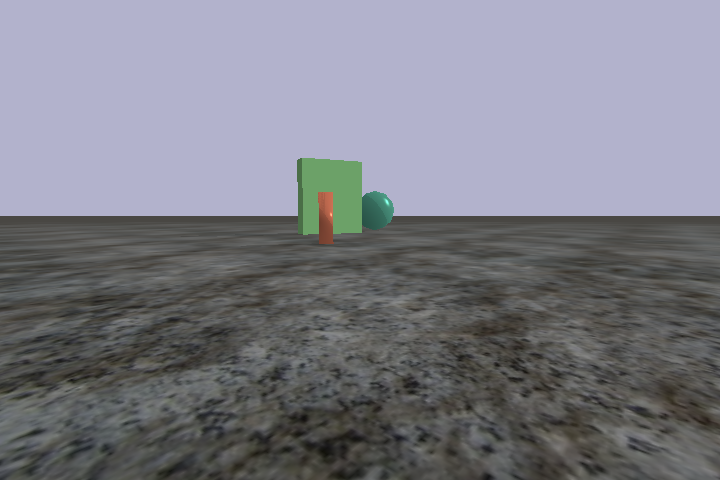

torch.Size([7, 512])
tensor([0.2339, 0.2369, 0.2908, 0.3083, 0.2534, 0.2382, 0.2344],
       device='mps:0', dtype=torch.float16)


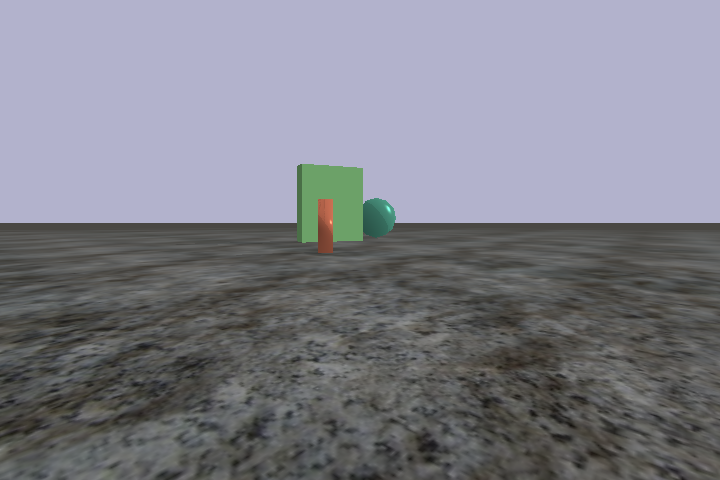

torch.Size([7, 512])
tensor([0.2405, 0.2411, 0.2937, 0.3081, 0.2583, 0.2382, 0.2300],
       device='mps:0', dtype=torch.float16)


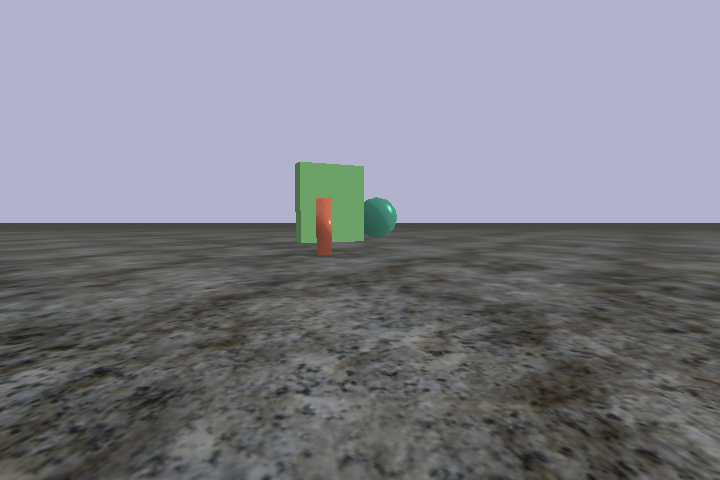

torch.Size([7, 512])
tensor([0.2358, 0.2435, 0.2766, 0.3062, 0.2581, 0.2389, 0.2307],
       device='mps:0', dtype=torch.float16)


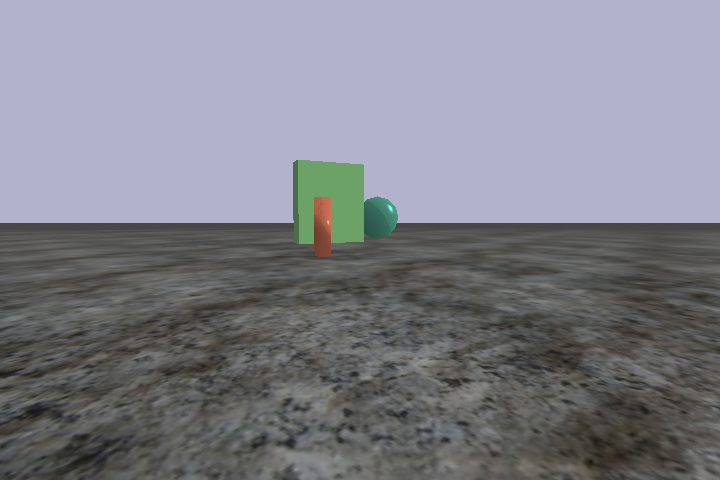

torch.Size([7, 512])
tensor([0.2385, 0.2373, 0.2766, 0.2961, 0.2549, 0.2379, 0.2301],
       device='mps:0', dtype=torch.float16)


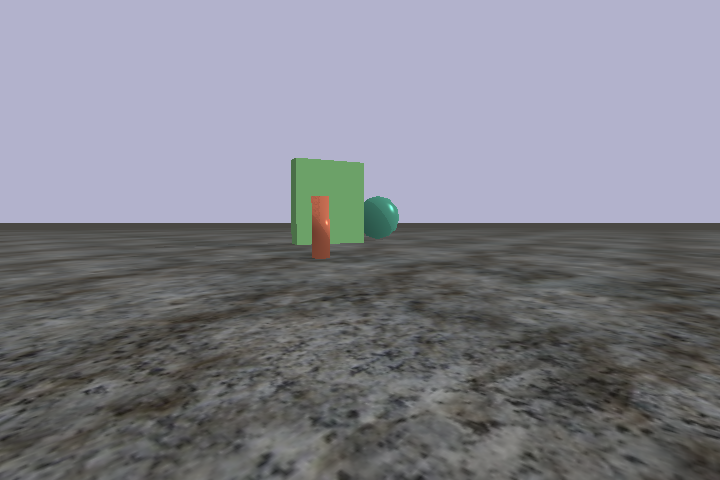

torch.Size([7, 512])
tensor([0.2391, 0.2380, 0.2839, 0.2947, 0.2551, 0.2408, 0.2313],
       device='mps:0', dtype=torch.float16)


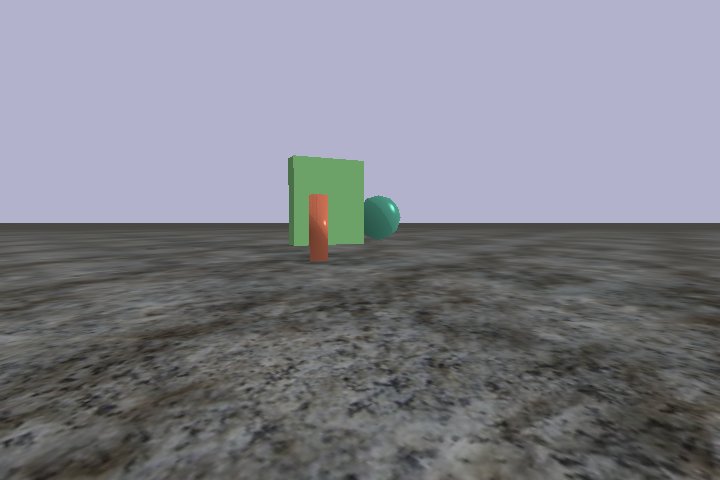

torch.Size([7, 512])
tensor([0.2413, 0.2372, 0.2903, 0.2917, 0.2546, 0.2408, 0.2308],
       device='mps:0', dtype=torch.float16)


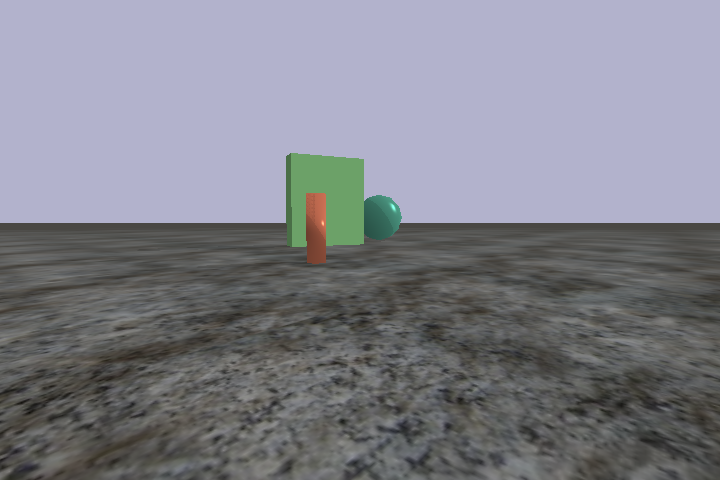

torch.Size([7, 512])
tensor([0.2329, 0.2405, 0.2949, 0.2991, 0.2600, 0.2385, 0.2352],
       device='mps:0', dtype=torch.float16)


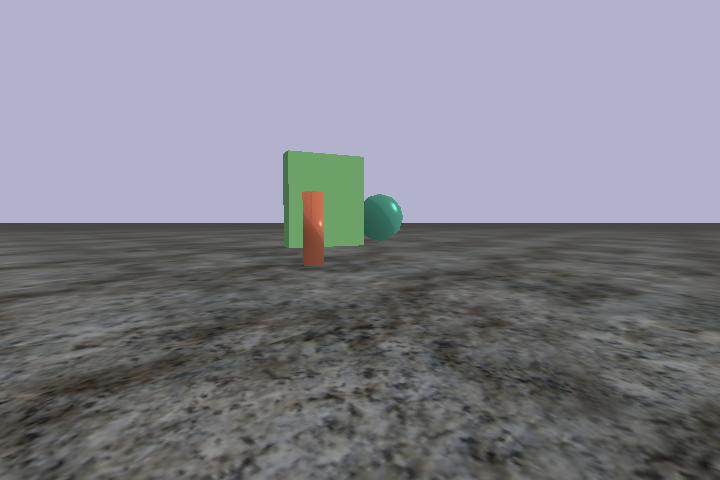

torch.Size([7, 512])
tensor([0.2347, 0.2369, 0.2986, 0.2991, 0.2563, 0.2401, 0.2332],
       device='mps:0', dtype=torch.float16)


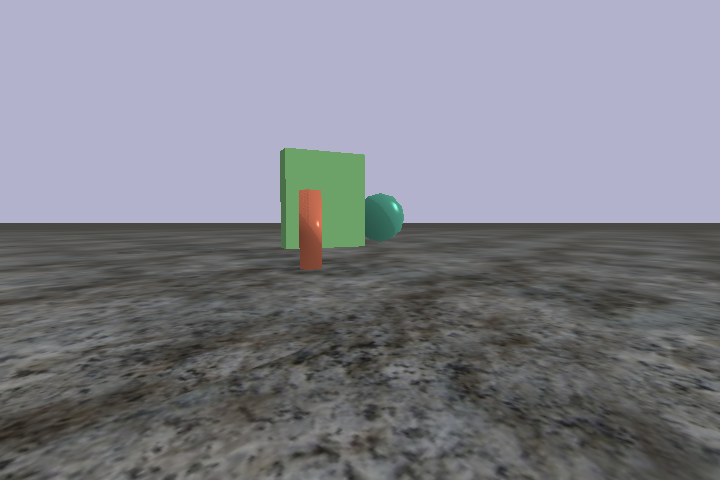

torch.Size([7, 512])
tensor([0.2358, 0.2368, 0.3005, 0.2981, 0.2517, 0.2415, 0.2325],
       device='mps:0', dtype=torch.float16)


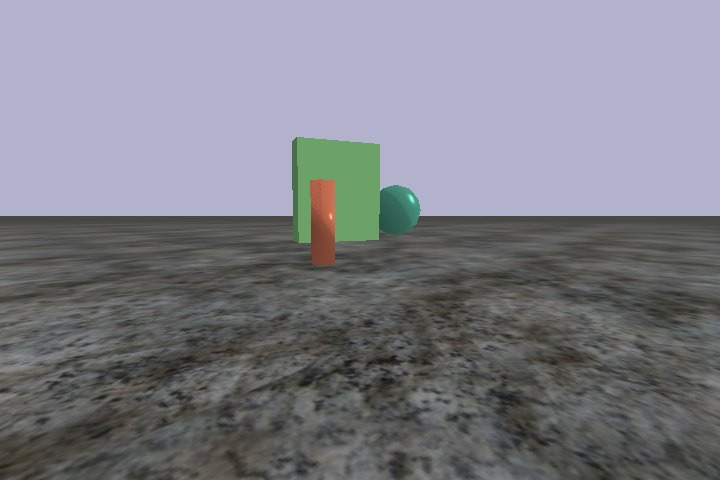

torch.Size([7, 512])
tensor([0.2328, 0.2369, 0.2888, 0.3035, 0.2639, 0.2430, 0.2379],
       device='mps:0', dtype=torch.float16)


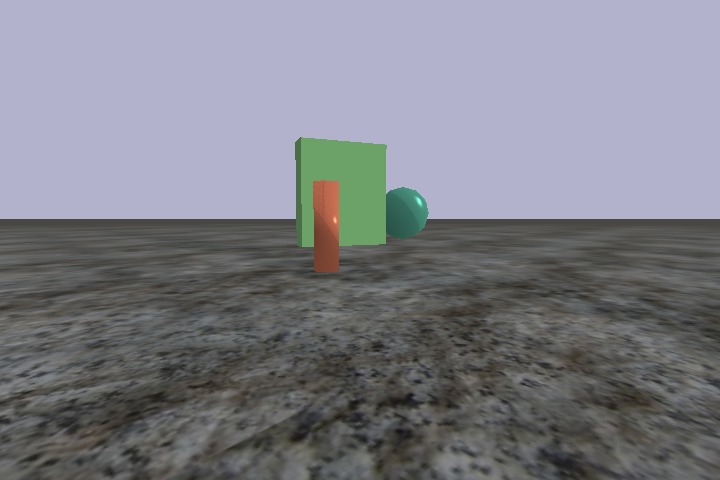

torch.Size([7, 512])
tensor([0.2374, 0.2377, 0.2856, 0.3064, 0.2705, 0.2366, 0.2365],
       device='mps:0', dtype=torch.float16)


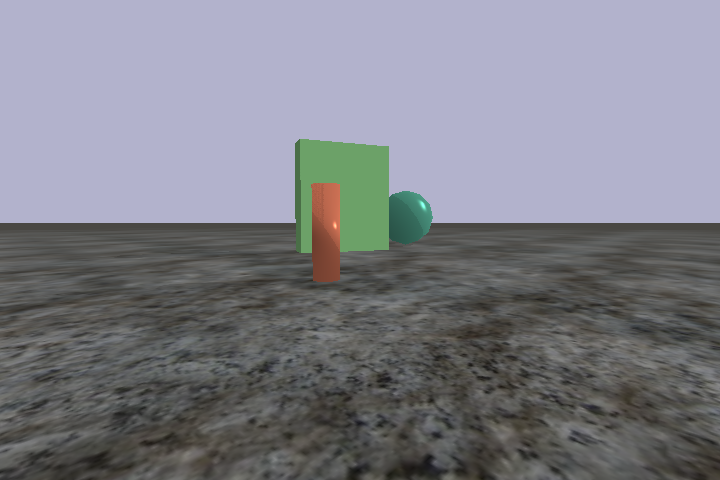

torch.Size([7, 512])
tensor([0.2388, 0.2410, 0.2871, 0.3079, 0.2720, 0.2437, 0.2399],
       device='mps:0', dtype=torch.float16)


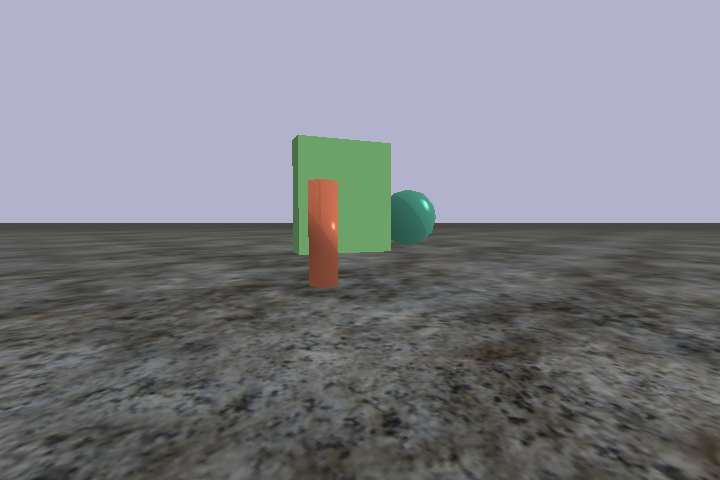

torch.Size([7, 512])
tensor([0.2393, 0.2378, 0.2896, 0.2988, 0.2664, 0.2412, 0.2372],
       device='mps:0', dtype=torch.float16)


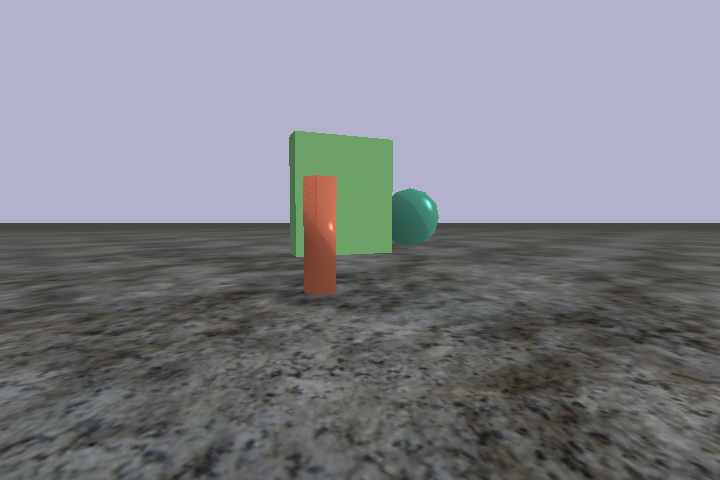

torch.Size([7, 512])
tensor([0.2366, 0.2391, 0.2947, 0.2937, 0.2690, 0.2390, 0.2347],
       device='mps:0', dtype=torch.float16)


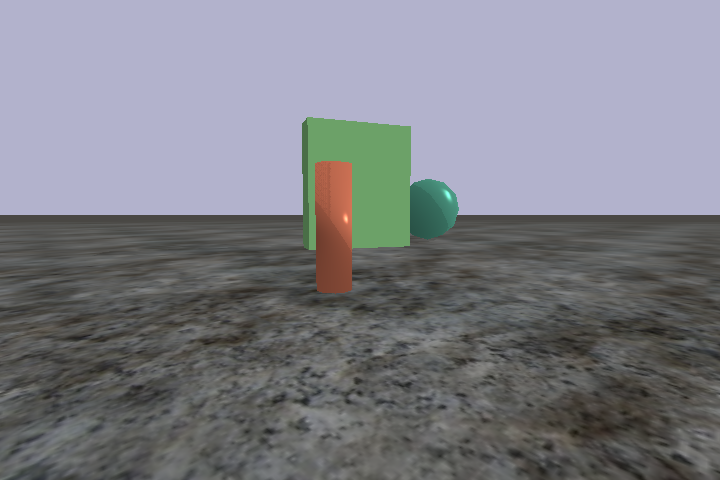

torch.Size([7, 512])
tensor([0.2307, 0.2378, 0.2898, 0.2917, 0.2793, 0.2375, 0.2424],
       device='mps:0', dtype=torch.float16)


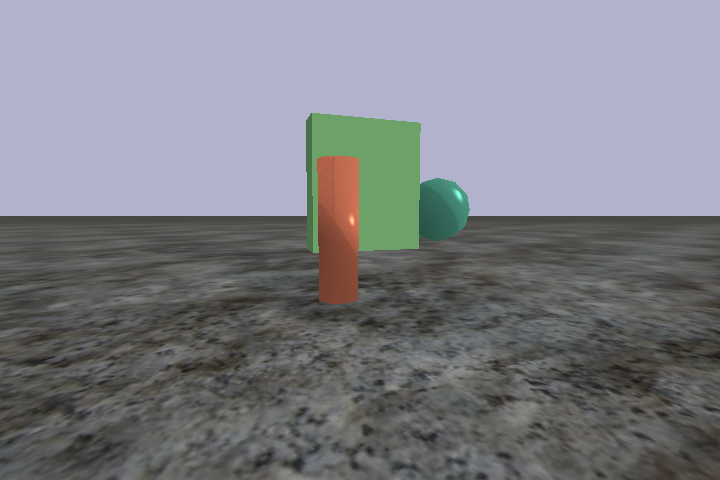

torch.Size([7, 512])
tensor([0.2312, 0.2350, 0.2808, 0.3003, 0.2791, 0.2377, 0.2361],
       device='mps:0', dtype=torch.float16)


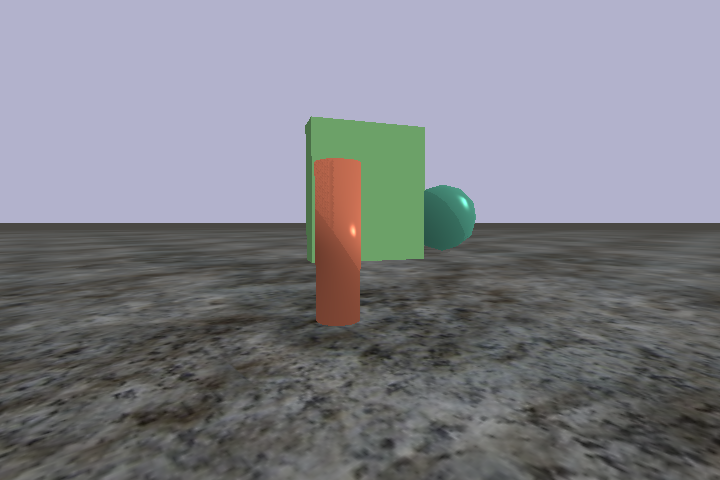

torch.Size([7, 512])
tensor([0.2314, 0.2362, 0.2690, 0.2922, 0.2834, 0.2383, 0.2375],
       device='mps:0', dtype=torch.float16)


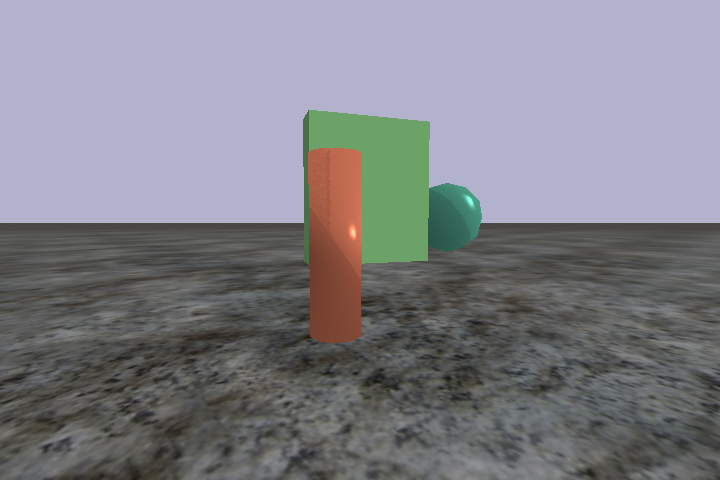

torch.Size([7, 512])
tensor([0.2296, 0.2377, 0.2759, 0.2976, 0.2856, 0.2386, 0.2377],
       device='mps:0', dtype=torch.float16)


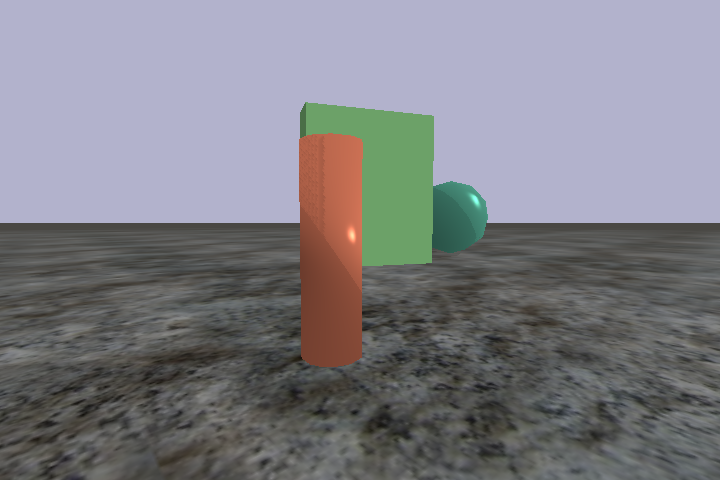

torch.Size([7, 512])
tensor([0.2362, 0.2347, 0.2595, 0.2847, 0.2808, 0.2610, 0.2356],
       device='mps:0', dtype=torch.float16)


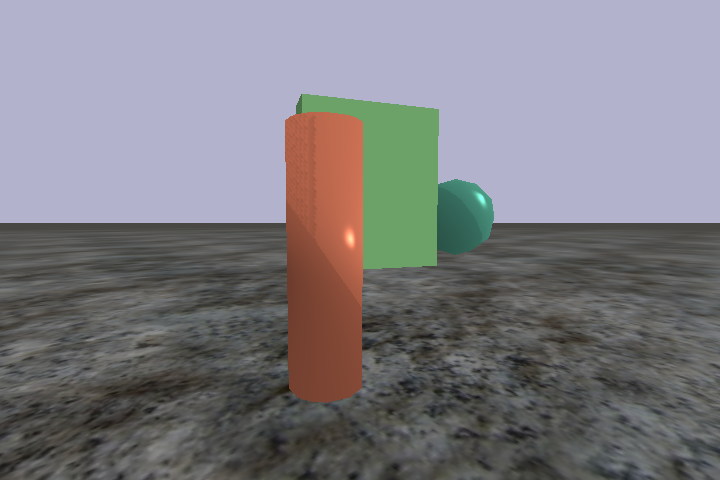

torch.Size([7, 512])
tensor([0.2372, 0.2437, 0.2664, 0.2876, 0.2810, 0.2573, 0.2325],
       device='mps:0', dtype=torch.float16)


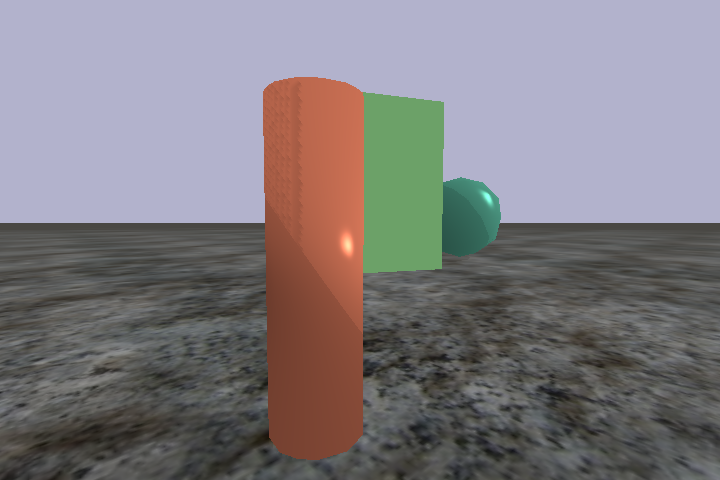

torch.Size([7, 512])
tensor([0.2365, 0.2400, 0.2732, 0.2949, 0.2810, 0.2495, 0.2345],
       device='mps:0', dtype=torch.float16)


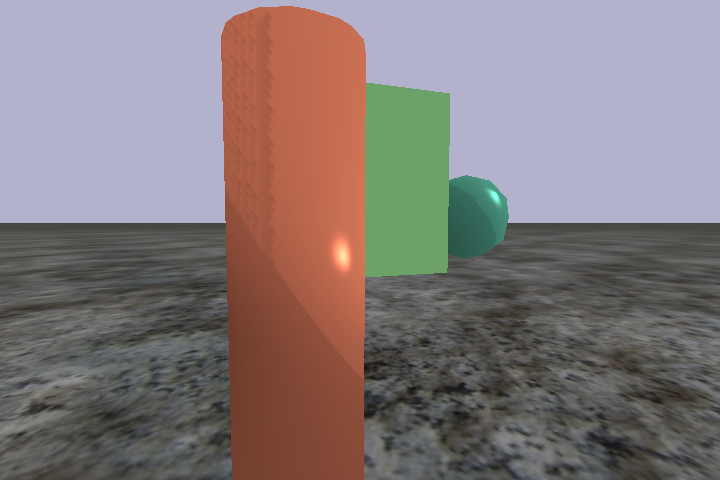

torch.Size([7, 512])
tensor([0.2411, 0.2490, 0.2749, 0.3010, 0.2834, 0.2534, 0.2346],
       device='mps:0', dtype=torch.float16)


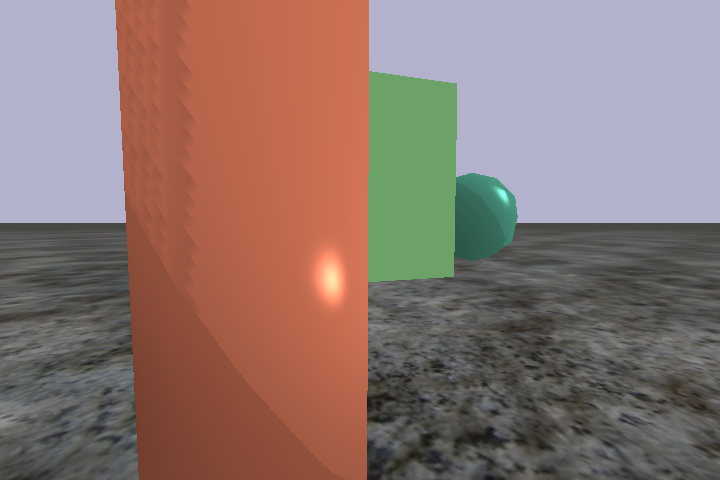

torch.Size([7, 512])
tensor([0.2612, 0.2720, 0.2725, 0.3074, 0.2888, 0.2603, 0.2313],
       device='mps:0', dtype=torch.float16)


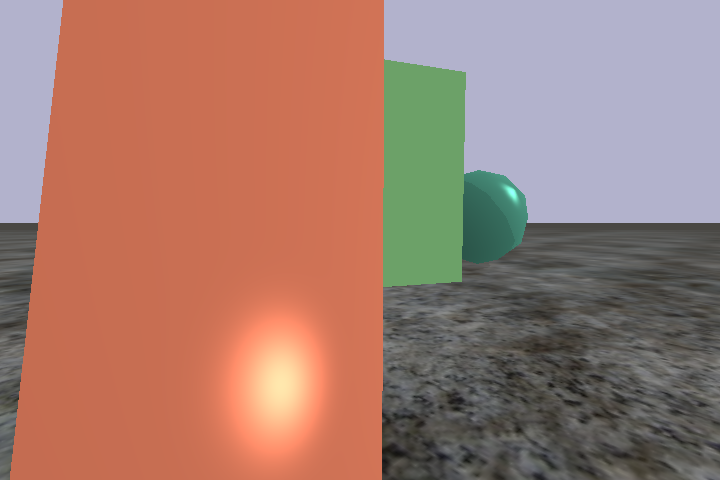

torch.Size([7, 512])
tensor([0.2712, 0.2715, 0.2847, 0.2974, 0.2903, 0.2639, 0.2361],
       device='mps:0', dtype=torch.float16)


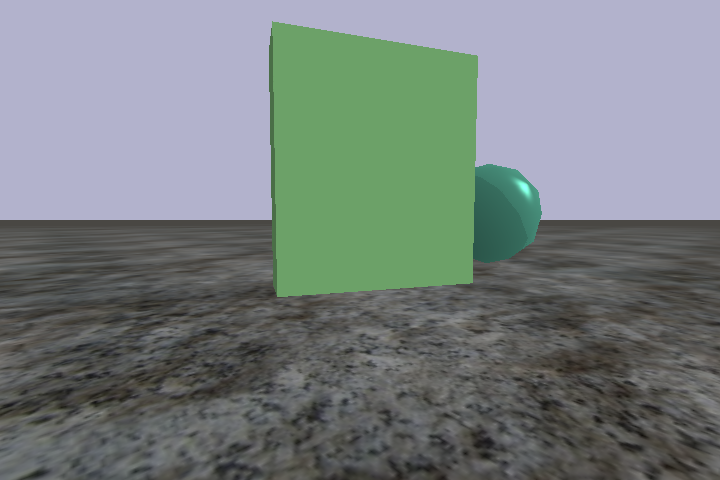

torch.Size([7, 512])
tensor([0.2363, 0.2440, 0.2847, 0.2720, 0.2849, 0.2612, 0.2365],
       device='mps:0', dtype=torch.float16)


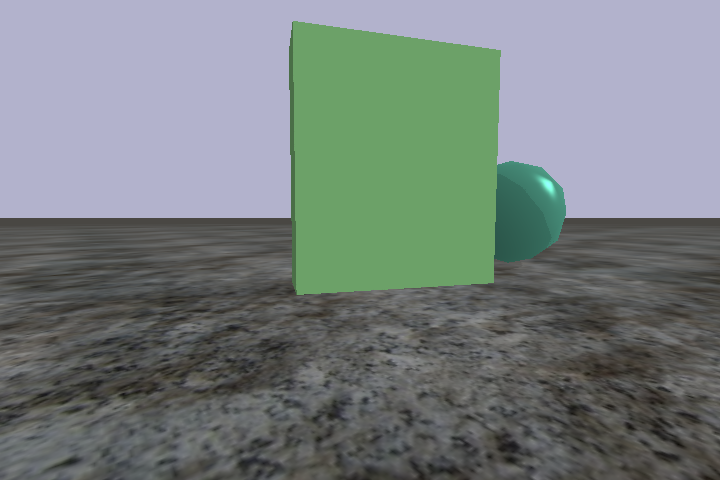

torch.Size([7, 512])
tensor([0.2312, 0.2365, 0.2761, 0.2681, 0.2864, 0.2639, 0.2340],
       device='mps:0', dtype=torch.float16)


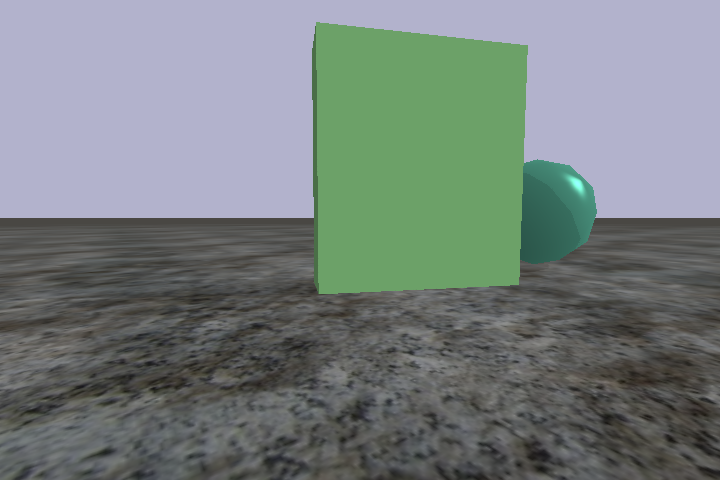

torch.Size([7, 512])
tensor([0.2324, 0.2345, 0.2744, 0.2795, 0.2708, 0.2739, 0.2549],
       device='mps:0', dtype=torch.float16)


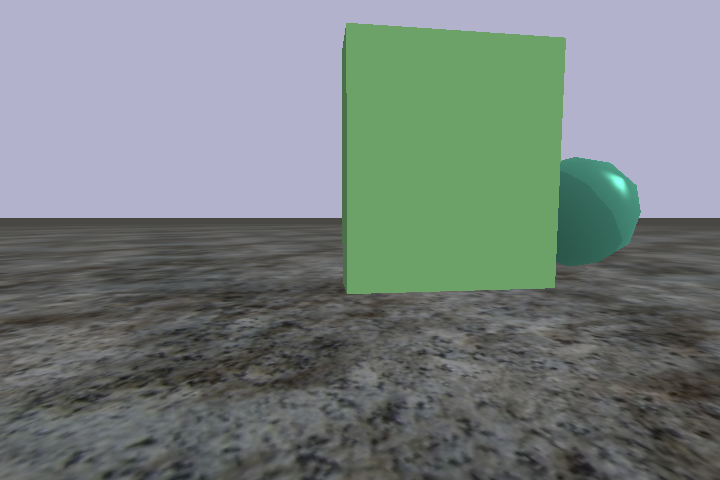

torch.Size([7, 512])
tensor([0.2408, 0.2318, 0.2417, 0.2810, 0.2649, 0.2742, 0.2600],
       device='mps:0', dtype=torch.float16)


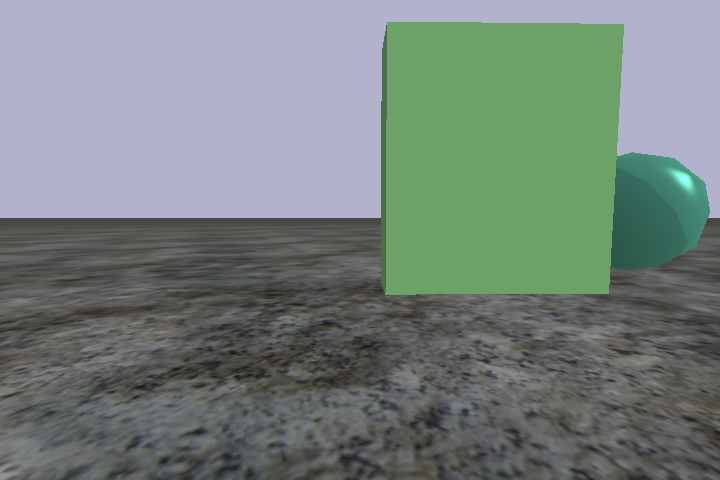

torch.Size([7, 512])
tensor([0.2388, 0.2324, 0.2391, 0.2778, 0.2717, 0.2805, 0.2678],
       device='mps:0', dtype=torch.float16)


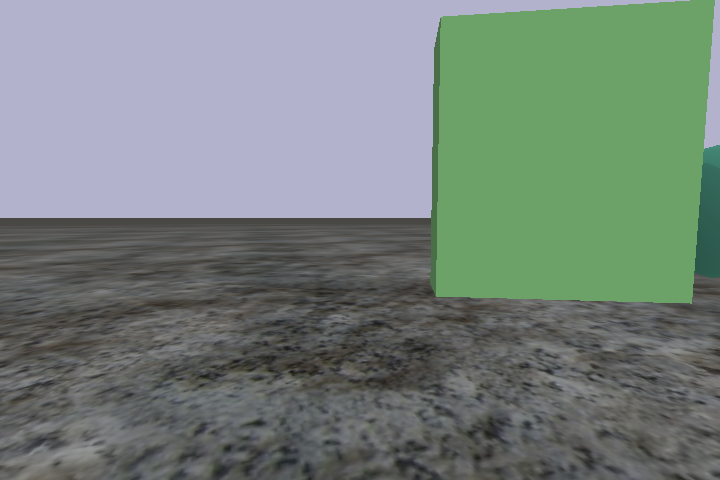

torch.Size([7, 512])
tensor([0.2366, 0.2394, 0.2373, 0.2622, 0.2812, 0.2620, 0.2620],
       device='mps:0', dtype=torch.float16)


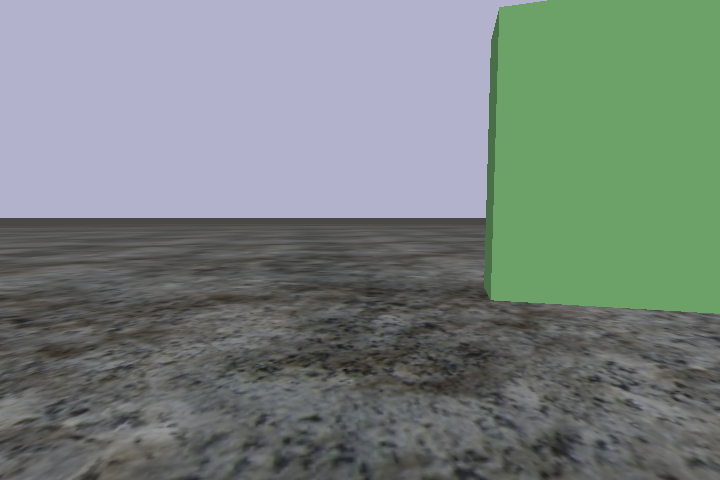

torch.Size([7, 512])
tensor([0.2363, 0.2433, 0.2430, 0.2401, 0.2847, 0.2583, 0.2712],
       device='mps:0', dtype=torch.float16)


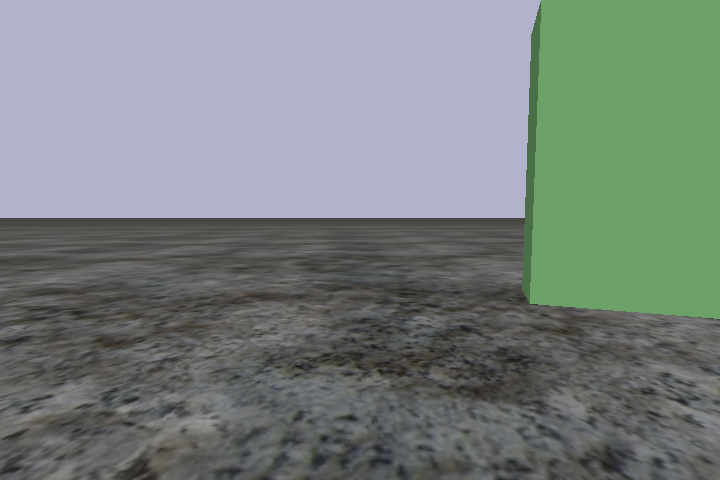

torch.Size([7, 512])
tensor([0.2365, 0.2408, 0.2407, 0.2363, 0.2891, 0.2927, 0.2729],
       device='mps:0', dtype=torch.float16)


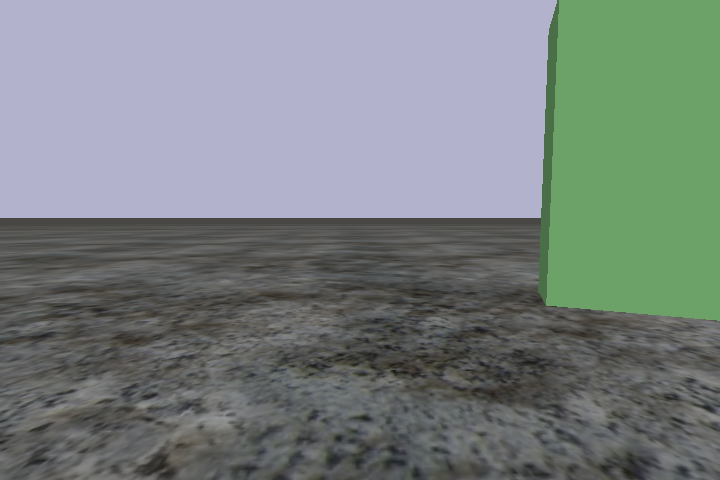

torch.Size([7, 512])
tensor([0.2412, 0.2402, 0.2378, 0.2379, 0.2408, 0.2825, 0.2729],
       device='mps:0', dtype=torch.float16)


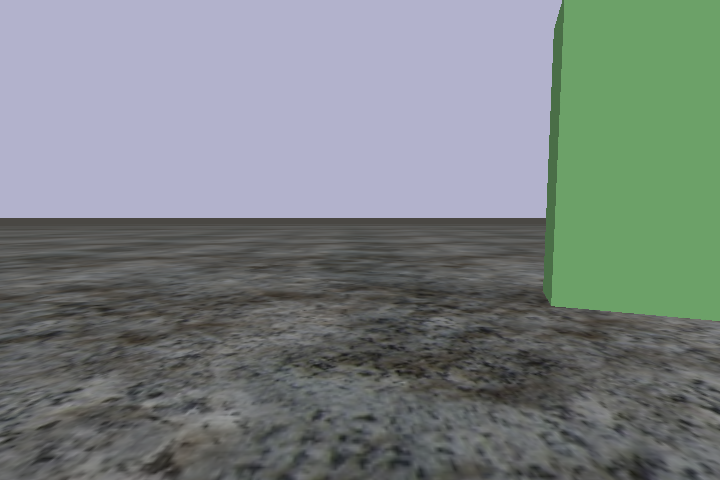

torch.Size([7, 512])
tensor([0.2383, 0.2383, 0.2358, 0.2382, 0.2430, 0.2881, 0.2729],
       device='mps:0', dtype=torch.float16)


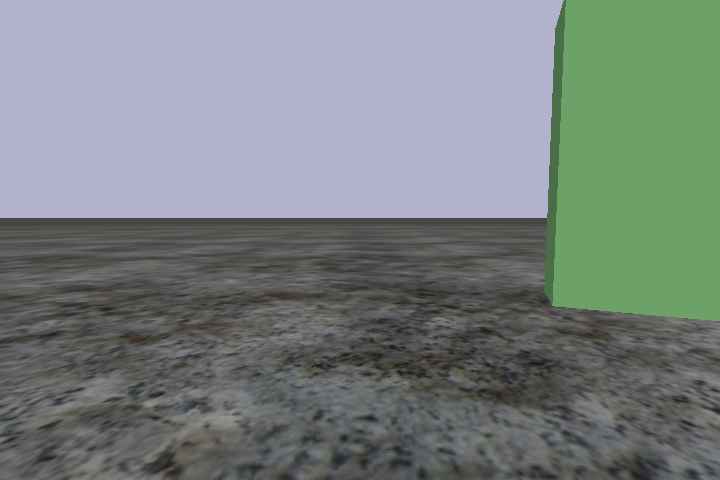

torch.Size([7, 512])
tensor([0.2375, 0.2378, 0.2363, 0.2385, 0.2441, 0.2944, 0.2729],
       device='mps:0', dtype=torch.float16)


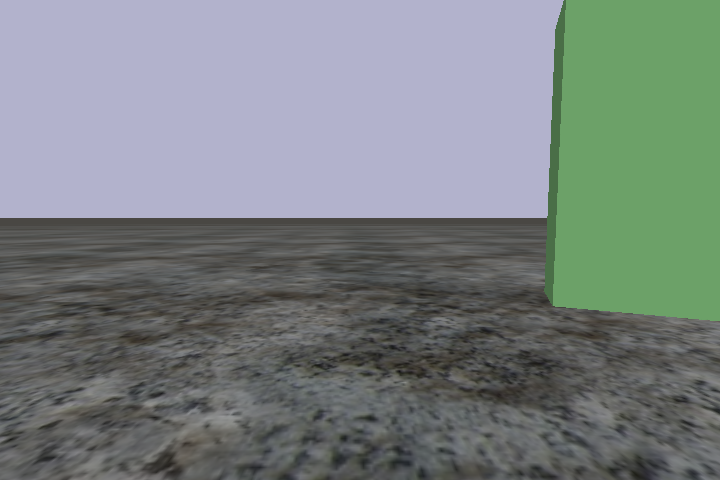

torch.Size([7, 512])
tensor([0.2377, 0.2375, 0.2356, 0.2388, 0.2434, 0.2920, 0.2729],
       device='mps:0', dtype=torch.float16)


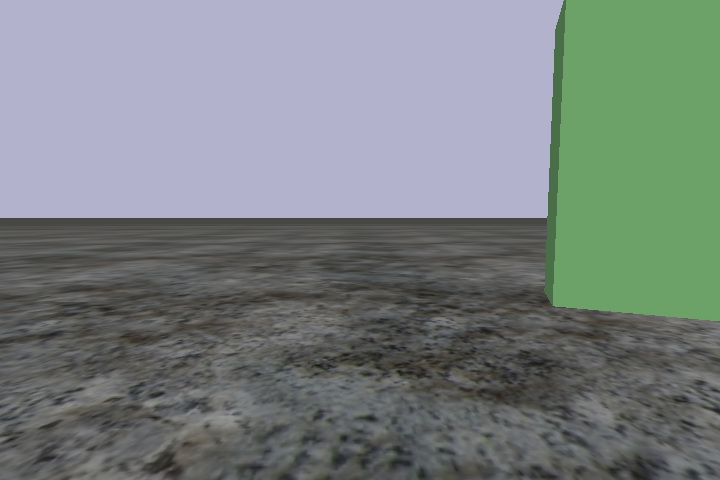

torch.Size([7, 512])
tensor([0.2377, 0.2377, 0.2361, 0.2384, 0.2435, 0.2915, 0.2729],
       device='mps:0', dtype=torch.float16)


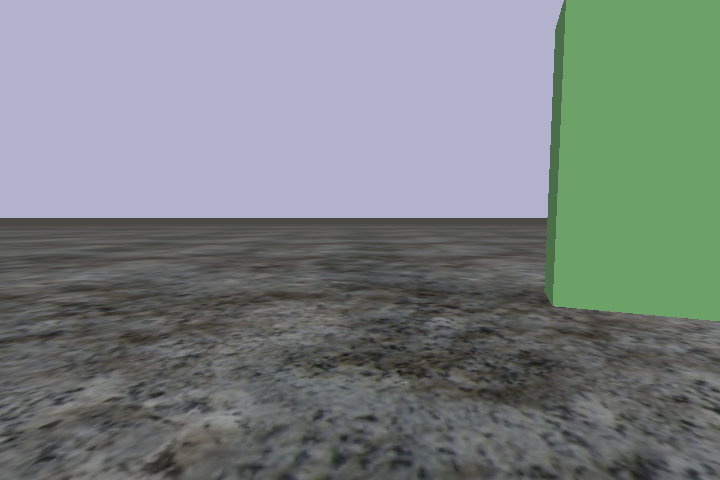

torch.Size([7, 512])
tensor([0.2375, 0.2373, 0.2360, 0.2388, 0.2433, 0.2913, 0.2729],
       device='mps:0', dtype=torch.float16)


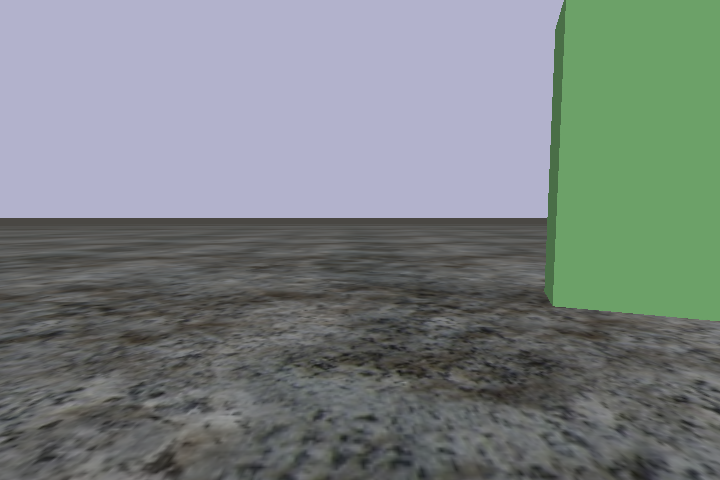

torch.Size([7, 512])
tensor([0.2374, 0.2373, 0.2362, 0.2380, 0.2434, 0.2910, 0.2729],
       device='mps:0', dtype=torch.float16)


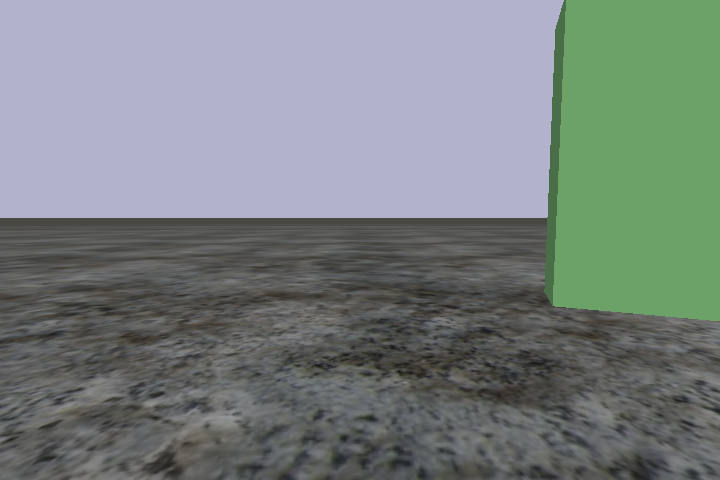

torch.Size([7, 512])
tensor([0.2377, 0.2374, 0.2361, 0.2385, 0.2437, 0.2910, 0.2729],
       device='mps:0', dtype=torch.float16)


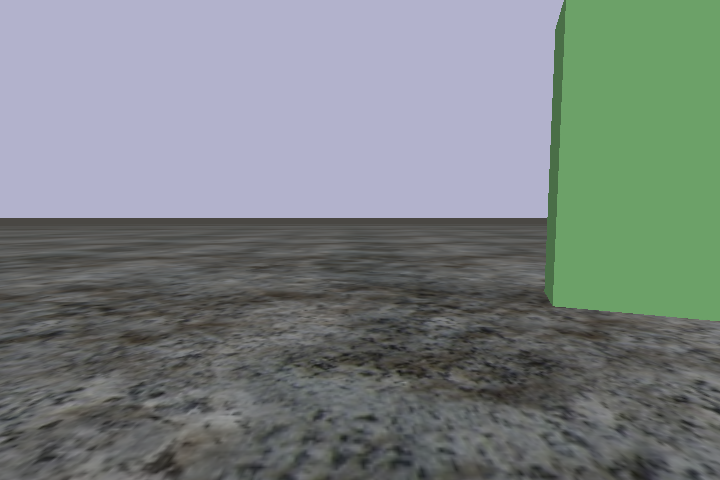

torch.Size([7, 512])
tensor([0.2375, 0.2373, 0.2363, 0.2383, 0.2432, 0.2903, 0.2729],
       device='mps:0', dtype=torch.float16)


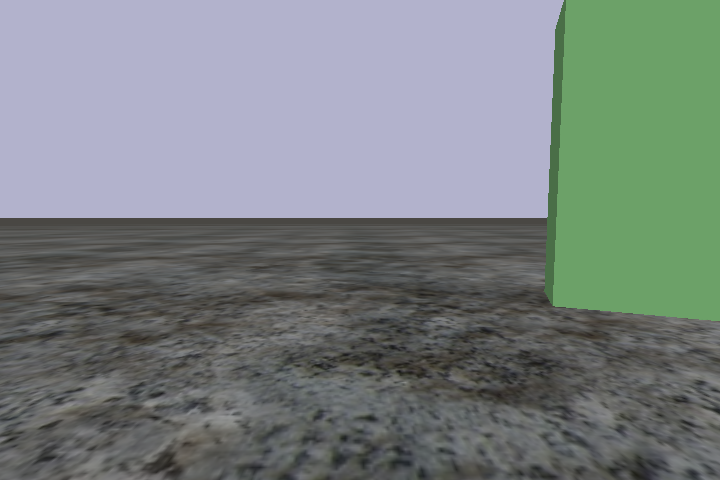

torch.Size([7, 512])
tensor([0.2377, 0.2373, 0.2361, 0.2384, 0.2429, 0.2903, 0.2729],
       device='mps:0', dtype=torch.float16)


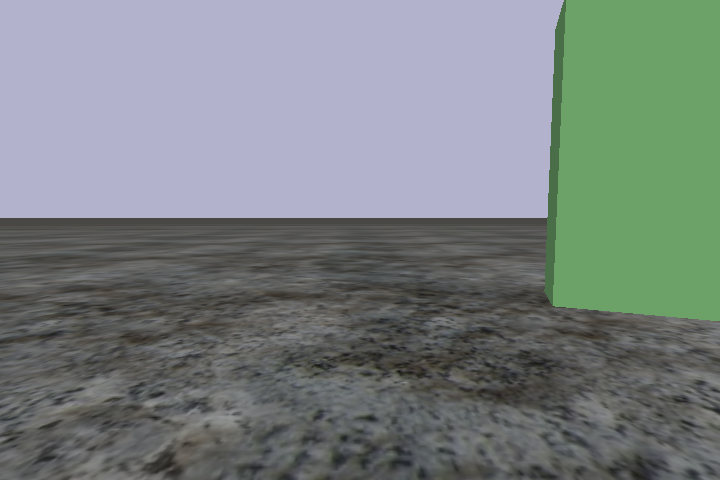

torch.Size([7, 512])
tensor([0.2373, 0.2373, 0.2358, 0.2382, 0.2435, 0.2903, 0.2729],
       device='mps:0', dtype=torch.float16)


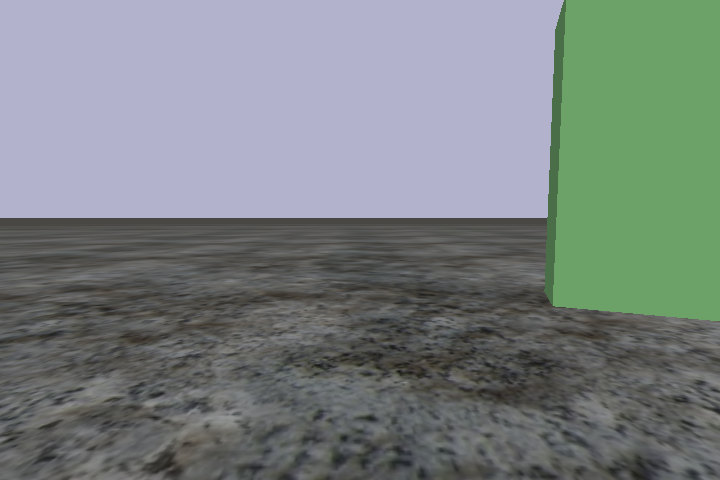

torch.Size([7, 512])
tensor([0.2374, 0.2372, 0.2358, 0.2384, 0.2434, 0.2903, 0.2729],
       device='mps:0', dtype=torch.float16)


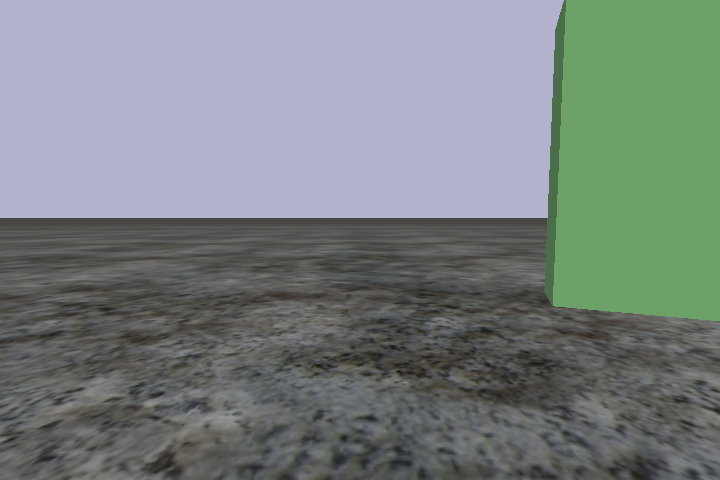

torch.Size([7, 512])
tensor([0.2372, 0.2373, 0.2357, 0.2385, 0.2432, 0.2930, 0.2729],
       device='mps:0', dtype=torch.float16)


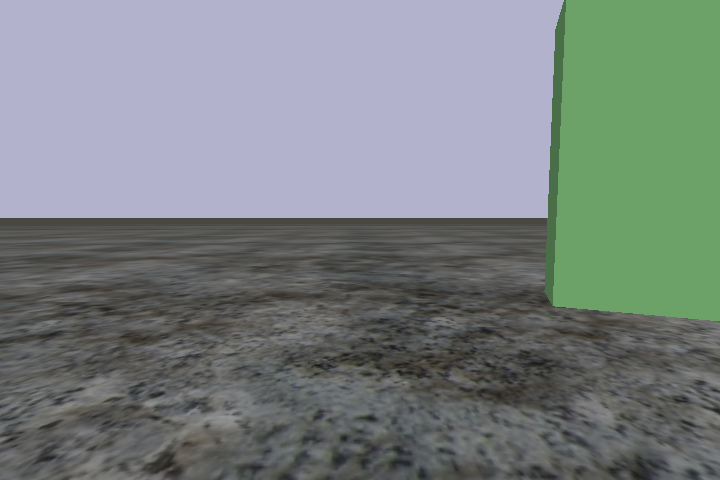

torch.Size([7, 512])
tensor([0.2371, 0.2372, 0.2357, 0.2383, 0.2433, 0.2930, 0.2729],
       device='mps:0', dtype=torch.float16)


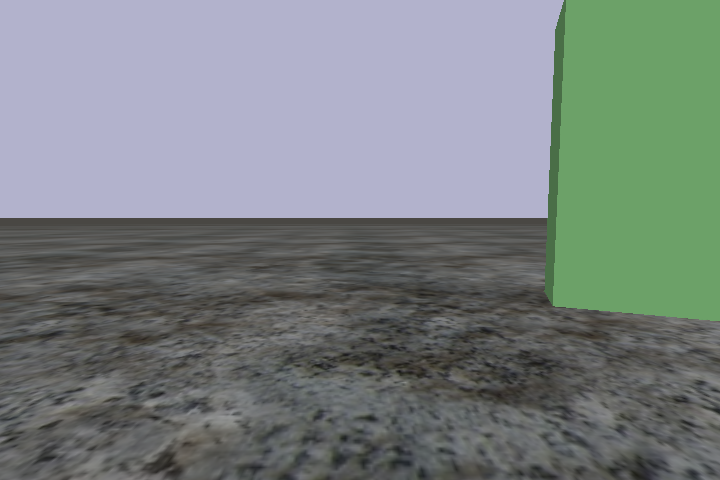

torch.Size([7, 512])
tensor([0.2371, 0.2372, 0.2355, 0.2384, 0.2432, 0.2930, 0.2729],
       device='mps:0', dtype=torch.float16)


KeyboardInterrupt: 

In [10]:
v,w = 0.0, 0.0
_prev_v, _prev_w = 0.0, 0.0
prompt = "A orange rectangle on the ground in front off a green rectangle"

while True:
    camera_feed = env.step(steps=20, cmd=(v, w), camera_feed=True)
    # plot the camera feed
    plot_camera_feed(camera_feed)
    v,w = compute_next_cmd(v, w, camera_feed, prompt)



In [ ]:
env.reset_pose()

error: Not connected to physics server.

In [3]:
# quit the simulation without crashing the notebook and close the pybullet windo
p.disconnect()


numActiveThreads = 0
stopping threads
Thread with taskId 0 exiting
Thread TERMINATED
destroy semaphore
semaphore destroyed
destroy main semaphore
main semaphore destroyed
